**Tomato Leaf Disease Detection USING CNN TENSORFLOW**

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Tensorflow module
import tensorflow as tf
from tensorflow import keras

from tensorflow.keras import models, layers

from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau


from tensorflow.keras.models import Model
from tensorflow.keras import layers
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator


In [2]:
# fixed Values
batch_size = 32
image_size = 255
channels=3
seed=123
ep = 10

In [3]:
train = "/kaggle/input/tomato-plant-dataset/TomattoLeaf/train"
val = "/kaggle/input/tomato-plant-dataset/TomattoLeaf/valid"

**Split training and testing fron train of 80% 20%**

In [4]:
train_generator = ImageDataGenerator(validation_split = 0.2,
                                     featurewise_center=True,
                                     preprocessing_function = None,
                                     rotation_range = 45,
                                     rescale=1./image_size,
                                     zoom_range = 0.2,
                                     horizontal_flip = True,
                                     vertical_flip = True,
                                     fill_mode = 'nearest',
                                     shear_range = 0.2,
                                     height_shift_range = 0.1,
                                     width_shift_range = 0.1)

test_datagen = ImageDataGenerator(rescale=1./image_size,validation_split = 0.2)
validation_generator =  ImageDataGenerator(rescale=1./image_size)

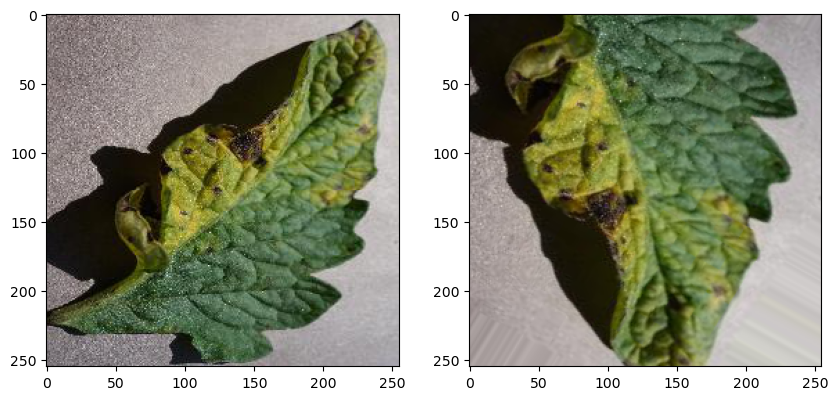

In [6]:
# Load an example image
path = "/kaggle/input/tomato-plant-dataset/TomattoLeaf/valid/Tomato___Early_blight/03b7a13c-f5c0-44c4-beed-443841670e9a___RS_Erly.B 8225.JPG"
img = image.load_img(path, target_size = (image_size, image_size))

image_array = image.img_to_array(img)

# Reshape the array to (1, width, height, channels)
image_array = image_array.reshape((1,) + image_array.shape)

augmented_images = train_generator.flow(image_array, batch_size=1)
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].imshow(img)
ax[1].imshow(augmented_images.next()[0])
plt.show()


In [7]:
train_datagenerator = train_generator.flow_from_directory(
                                                          train,
                                                          target_size = (image_size, image_size),
                                                          batch_size = batch_size,
                                                          class_mode = "categorical",
                                                          subset='training',
                                                          shuffle=True,
                                                          )


test_datagenerator = test_datagen.flow_from_directory(train,
                                                      target_size=(image_size, image_size),
                                                      batch_size=batch_size,
                                                      class_mode='categorical',
                                                      subset='validation',
                                                      shuffle=True)

validation_datagenerator = validation_generator.flow_from_directory(
                                                          val,
                                                          target_size = (image_size, image_size),
                                                          batch_size = batch_size,
                                                          class_mode = "categorical")


Found 14678 images belonging to 10 classes.
Found 3667 images belonging to 10 classes.
Found 4585 images belonging to 10 classes.


**CNN MODEL**

In [11]:
input_shape = (image_size,image_size,channels)

In [12]:
model = keras.Sequential([
    layers.Conv2D(32,(3,3),activation="relu",padding="same",input_shape=input_shape),
    layers.BatchNormalization(),
    layers.Conv2D(32,(3,3),activation="relu",padding="same"),
    layers.BatchNormalization(),
    layers.MaxPooling2D(3,3),

    layers.Conv2D(64,(3,3),activation="relu",padding="same"),
    layers.BatchNormalization(),
    layers.Conv2D(64,(3,3),activation="relu",padding="same"),
    layers.BatchNormalization(),
    layers.MaxPooling2D(3,3),

    layers.Conv2D(128,(3,3),activation="relu",padding="same"),
    layers.BatchNormalization(),
    layers.Conv2D(128,(3,3),activation="relu",padding="same"),
    layers.BatchNormalization(),
    layers.MaxPooling2D(3,3),

    layers.Conv2D(256,(3,3),activation="relu",padding="same"),
    layers.BatchNormalization(),
    layers.Conv2D(256,(3,3),activation="relu",padding="same"),
    layers.BatchNormalization(),

    layers.Conv2D(512,(5,5),activation="relu",padding="same"),
    layers.BatchNormalization(),
    layers.Conv2D(512,(5,5),activation="relu",padding="same"),
    layers.BatchNormalization(),
    
    layers.MaxPooling2D(3, 3),

    layers.Flatten(),

    layers.Dense(1024, activation='relu'),
    layers.Dropout(0.5),
    
    layers.Dense(512, activation='relu'),
    layers.Dropout(0.5),

    layers.Dense(10,activation="softmax"),
    
])

model.build(input_shape=input_shape)

In [13]:
opt = keras.optimizers.Adam(learning_rate=0.00001)
model.compile(optimizer=opt,loss="categorical_crossentropy",metrics=['accuracy'])

In [14]:
print('EfficientNet CNN has %d layers' %len(model.layers))

EfficientNet CNN has 30 layers


In [34]:
checkpoint = ModelCheckpoint('best_model.h5',
                             monitor='val_loss',
                             save_best_only=True,
                             save_weights_only = False,
                             mode='min',verbose = 1)

earlystop = EarlyStopping(monitor='val_loss',
                          min_delta = 0.0001,
                          mode = 'min',
                          verbose = 1,
                          restore_best_weights = True,
                          patience = 5)

reduce_lr = ReduceLROnPlateau(monitor = 'val_loss',
                              factor = 0.3, 
                              patience = 2,
                              min_lr=0.00001,
                              min_delta = 0.0001,
                              mode = 'min',
                              verbose = 1)

In [35]:
fit_batch = round(len(validation_datagenerator))
step_batch = round(len(train_datagenerator))

In [36]:
history = model.fit(
    train_datagenerator,
    validation_data= validation_datagenerator,
    epochs = 10,
#     validation_steps = 12,
#     steps_per_epoch = 12,
    callbacks=[checkpoint, earlystop,reduce_lr])

Epoch 1/10
459/459 [==============================] - ETA: 0s - loss: 0.3890 - accuracy: 0.8724
Epoch 1: val_loss improved from inf to 0.94454, saving model to best_model.h5
459/459 [==============================] - 255s 556ms/step - loss: 0.3890 - accuracy: 0.8724 - val_loss: 0.9445 - val_accuracy: 0.7671 - lr: 1.0000e-05
Epoch 2/10
459/459 [==============================] - ETA: 0s - loss: 0.3251 - accuracy: 0.8976
Epoch 2: val_loss did not improve from 0.94454
459/459 [==============================] - 243s 530ms/step - loss: 0.3251 - accuracy: 0.8976 - val_loss: 0.9867 - val_accuracy: 0.7474 - lr: 1.0000e-05
Epoch 3/10
459/459 [==============================] - ETA: 0s - loss: 0.3029 - accuracy: 0.9012
Epoch 3: val_loss improved from 0.94454 to 0.81381, saving model to best_model.h5
459/459 [==============================] - 242s 527ms/step - loss: 0.3029 - accuracy: 0.9012 - val_loss: 0.8138 - val_accuracy: 0.7854 - lr: 1.0000e-05
Epoch 4/10
459/459 [=============================

In [37]:
test_loss,test_accurcy = model.evaluate(test_datagenerator)


115/115 [==============================] - 15s 130ms/step - loss: 0.7692 - accuracy: 0.7821


In [38]:
print(f"Test accuracy: {test_accurcy:.2%}")
print(f"Test loss: {test_loss:.2%}")

Test accuracy: 78.21%
Test loss: 76.92%


**Training and validation Graphs**

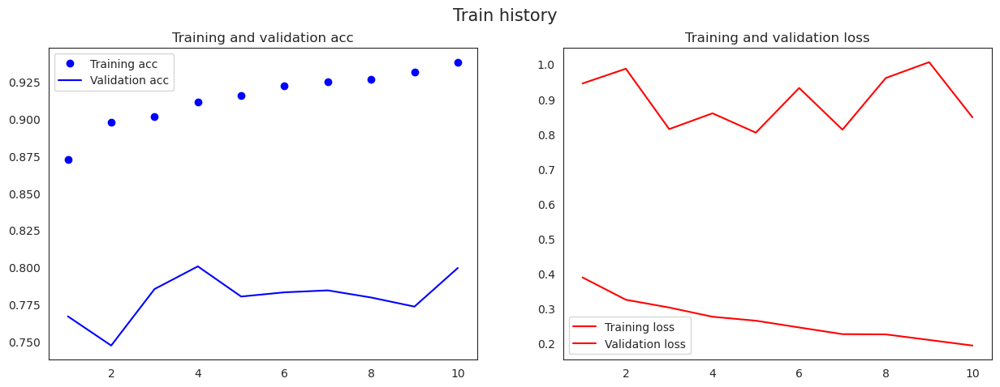

In [39]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))
sns.set_style("white")
plt.suptitle('Train history', size = 15)

ax1.plot(epochs, acc, "bo", label = "Training acc")
ax1.plot(epochs, val_acc, "b", label = "Validation acc")
ax1.set_title("Training and validation acc")
ax1.legend()

ax2.plot(epochs, loss,  label = "Training loss", color = 'red')
ax2.plot(epochs, val_loss, label = "Validation loss", color = 'red')
ax2.set_title("Training and validation loss")
ax2.legend()

plt.show()

In [41]:
convet = tf.lite.TFLiteConverter.from_keras_model(model)
tfile = convet.convert()
with open('modelLite.tflite','wb')as f:
    f.write(tfile)

**Visualize the Layered View of the Model**

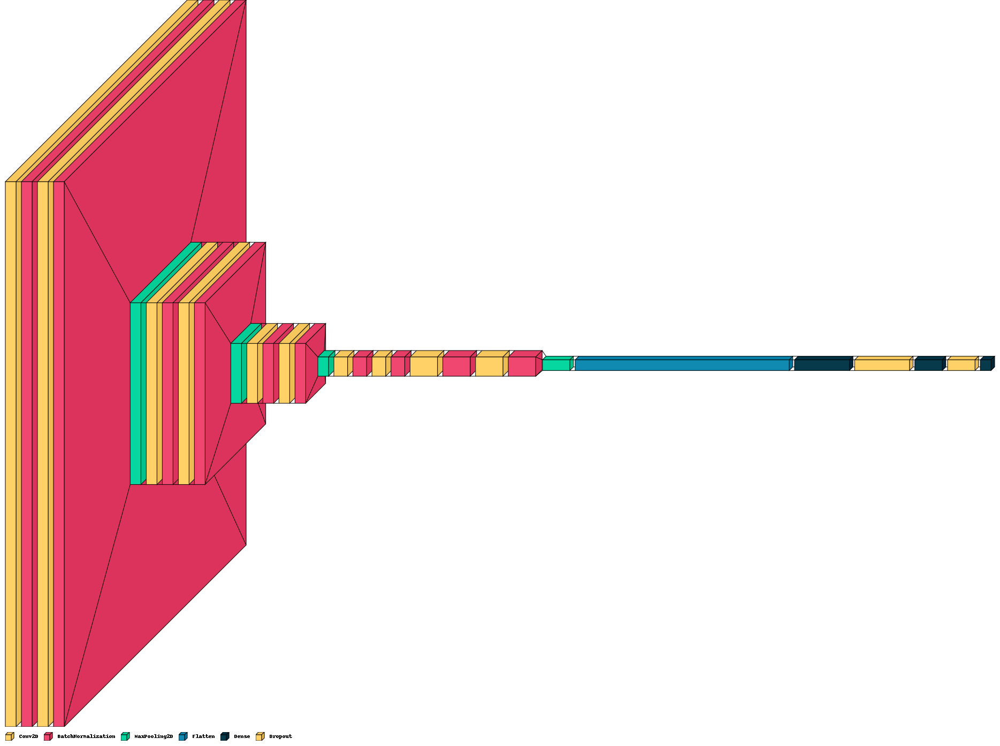

In [43]:
import visualkeras
visualkeras.layered_view(model, legend=True, draw_volume=True)

**CNN Layers**

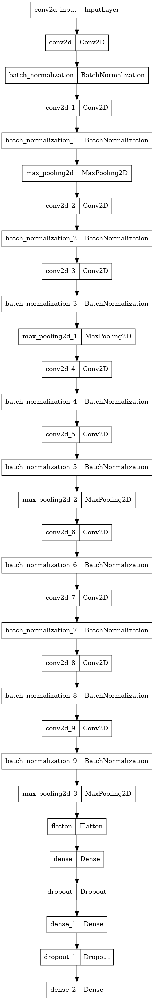

In [32]:
from keras.utils import plot_model
plot_model(model, to_file='model.png')

In [48]:
val_dataset = tf.keras.preprocessing.image_dataset_from_directory(val,seed=123,image_size=(image_size,image_size),batch_size=batch_size)
class_names = val_dataset.class_names


Found 4585 files belonging to 10 classes.


**Prediction of Single Image**

first image to predict
actual label: Tomato___Septoria_leaf_spot
1/1 [==============================] - 0s 34ms/step
predicted label: Tomato___Septoria_leaf_spot


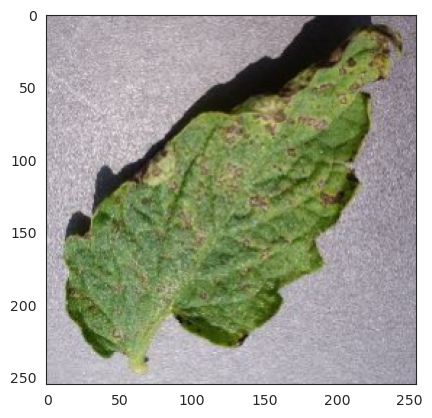

In [65]:
for images_batch, labels_batch in val_dataset.take(1):
    
    first_image = images_batch[0].numpy().astype('uint8')
    first_label = labels_batch[0].numpy()
    
    print("first image to predict")
    plt.imshow(first_image)
    print("actual label:",class_names[first_label])
    
    batch_prediction = model.predict(images_batch)
    print("predicted label:",class_names[np.argmax(batch_prediction[0])])

**Visualization of CNN intermediate activations**

1/1 [==============================] - 0s 123ms/step


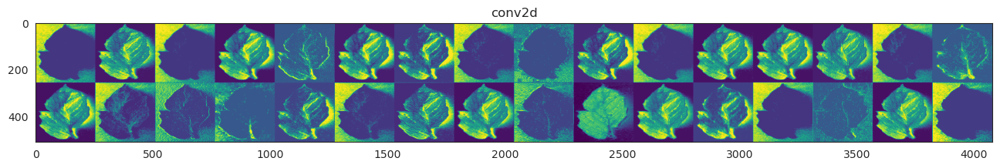

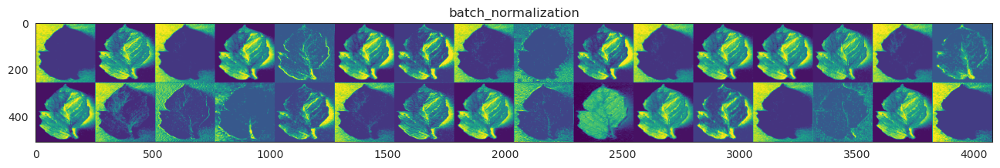

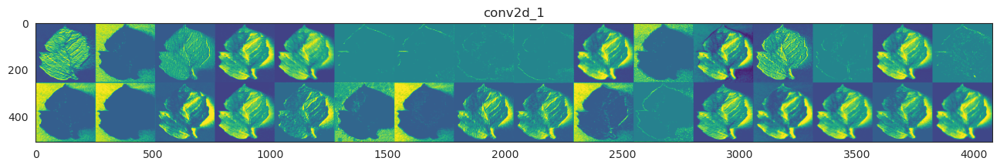

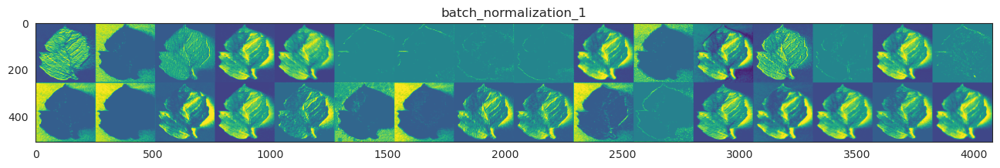

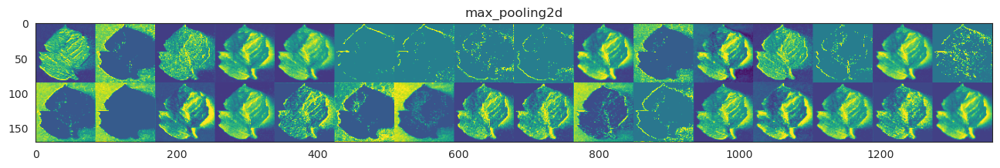

...

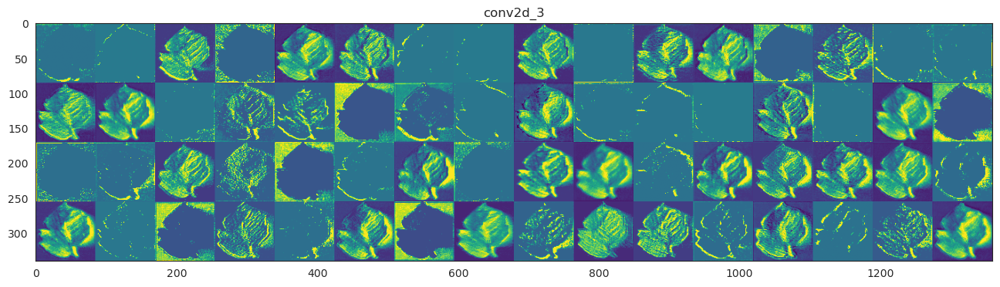

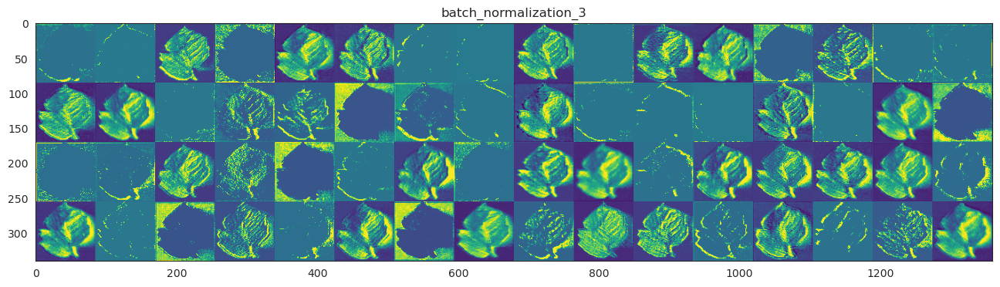

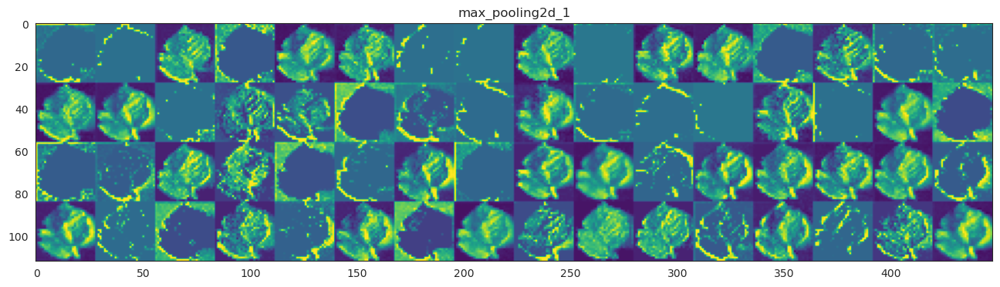

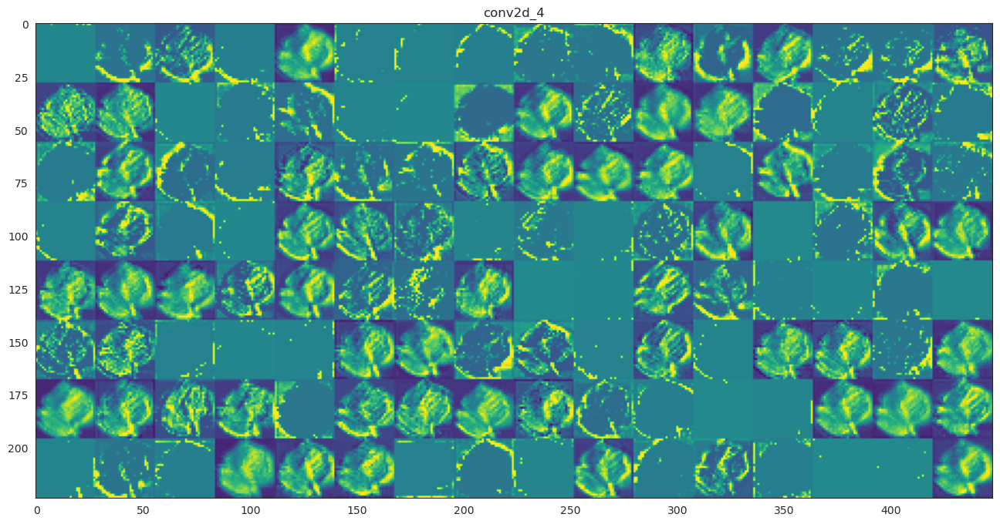

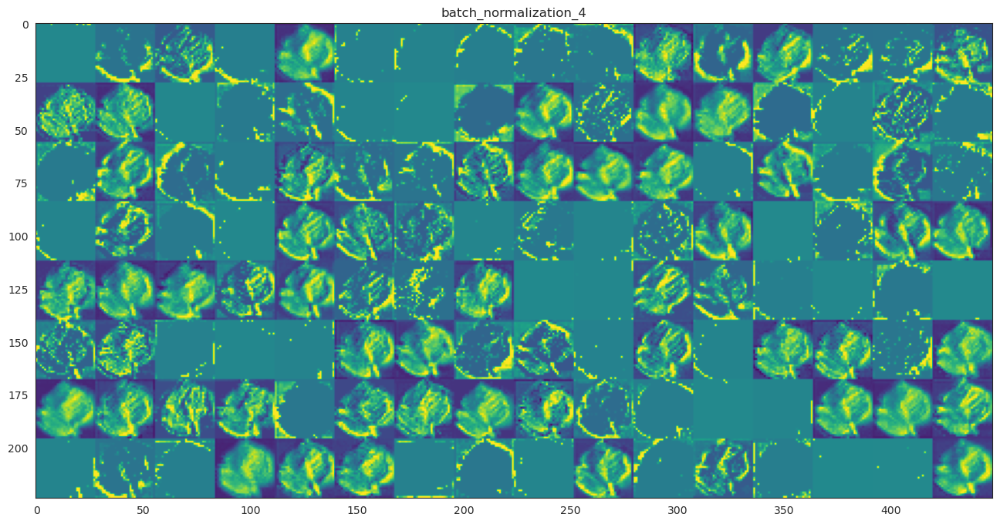

In [60]:

# Choose a random image from the test set
img = tf.keras.preprocessing.image.load_img(
    '/kaggle/input/tomato-plant-dataset/TomattoLeaf/valid/Tomato___Bacterial_spot/03ca5883-e9d6-4f88-81d8-90176fcc5413___GCREC_Bact.Sp 3013.JPG',
    target_size=(image_size, image_size)
)
x = tf.keras.preprocessing.image.img_to_array(img)
x = np.expand_dims(x, axis=0)
x = tf.keras.applications.vgg16.preprocess_input(x)

# Get the model's intermediate layer outputs
layer_outputs = [layer.output for layer in model.layers[:12]]
activation_model = tf.keras.models.Model(inputs=model.input, outputs=layer_outputs)
activations = activation_model.predict(x)

# Visualize the intermediate layer activations
layer_names = []
for layer in model.layers[:12]:
    layer_names.append(layer.name)

images_per_row = 16
for layer_name, layer_activation in zip(layer_names, activations):
    n_features = layer_activation.shape[-1]
    size = layer_activation.shape[1]
    n_cols = n_features // images_per_row
    display_grid = np.zeros((size * n_cols, images_per_row * size))
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0, :, :, col * images_per_row + row]
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col + 1) * size,
                         row * size : (row + 1) * size] = channel_image
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],
                        scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')
    
plt.show()

**F1 Score**

115/115 [==============================] - 11s 96ms/step


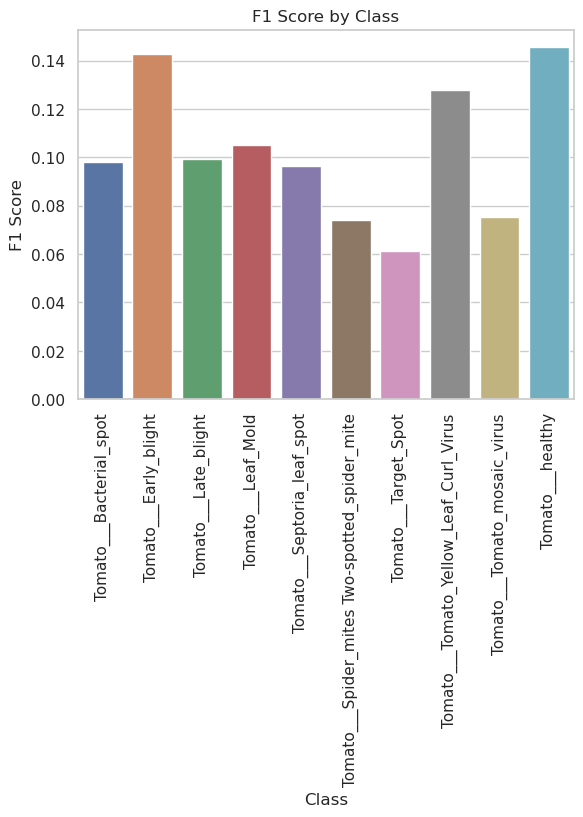

In [93]:
from sklearn.metrics import classification_report

y_pred = model.predict(test_datagenerator)
y_true = test_datagenerator.classes

y_pred = tf.argmax(y_pred, axis=1)

# Calculate F1 score
f1_score = classification_report(y_true, y_pred, target_names=test_datagenerator.class_indices.keys(), output_dict=True)
f1_scores = [f1_score[label]['f1-score'] for label in test_datagenerator.class_indices.keys()]

# Create dataframe with class names and F1 scores
df = pd.DataFrame({'class': test_datagenerator.class_indices.keys(), 'f1_score': f1_scores})

# Plot F1 score using a bar plot
sns.set(style='whitegrid')
ax = sns.barplot(x='class', y='f1_score', data=df)
ax.set_title('F1 Score by Class')
ax.set_xlabel('Class')
ax.set_ylabel('F1 Score')
plt.xticks(rotation=90)
plt.show()

**Confusion Matrix**

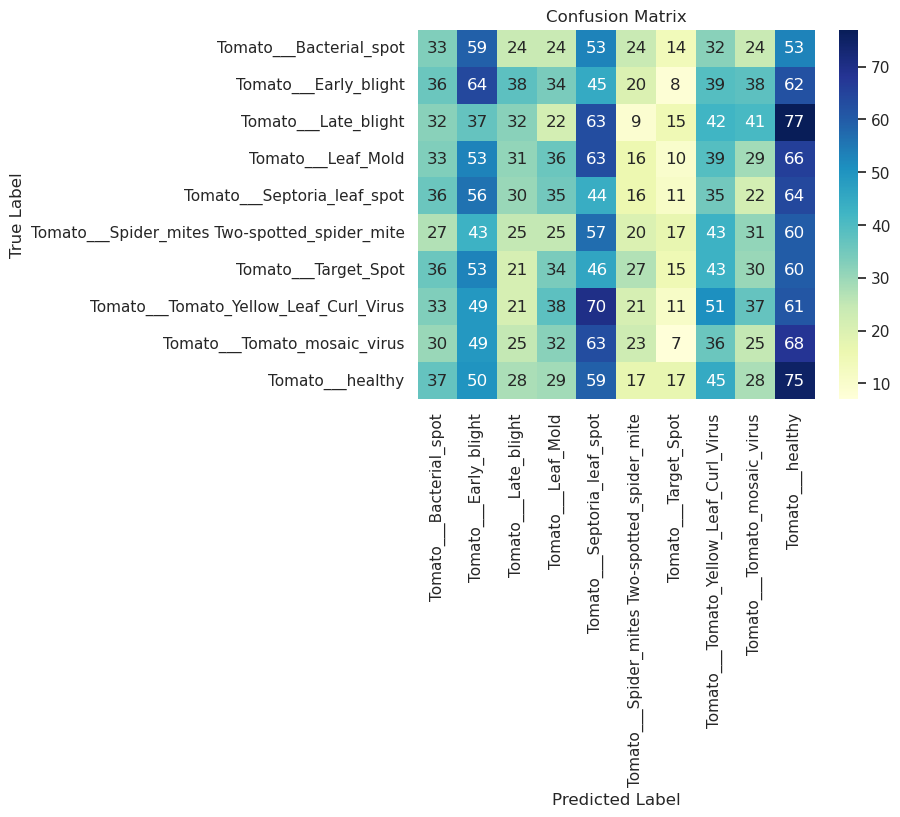

In [94]:
from sklearn.metrics import confusion_matrix

conf_matrix = confusion_matrix(y_true, y_pred, labels=range(len(test_datagenerator.class_indices)))

# Display confusion matrix using heatmap
sns.set()
ax = sns.heatmap(conf_matrix, annot=True, cmap="YlGnBu", xticklabels=test_datagenerator.class_indices.keys(),
                 yticklabels=test_datagenerator.class_indices.keys())
ax.set_title('Confusion Matrix')
ax.set_xlabel('Predicted Label')
ax.set_ylabel('True Label')
plt.show()

**Distribution of training and validation data**

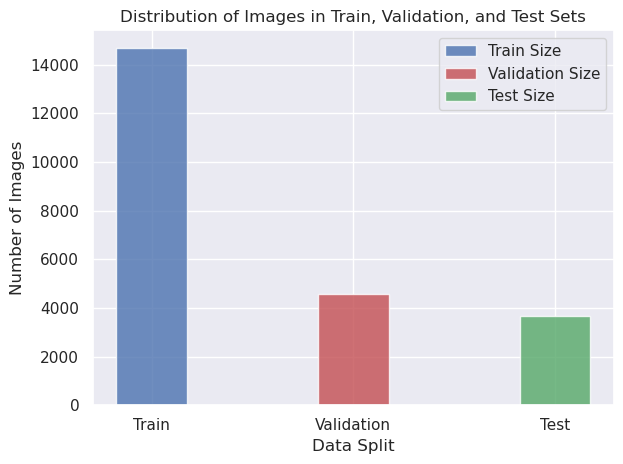

In [108]:
train_size = len(train_datagenerator.filenames)
val_size = len(validation_datagenerator.filenames)
test_size = len(test_datagenerator.filenames)

fig, ax = plt.subplots()
x = ['Train', 'Validation', 'Test']
bar_width = 0.35
opacity = 0.8

train_bars = ax.bar(x[0], train_size, bar_width, alpha=opacity, color='b', label='Train Size')
val_bars = ax.bar(x[1], val_size, bar_width, alpha=opacity, color='r', label='Validation Size')
test_bars = ax.bar(x[2], test_size, bar_width, alpha=opacity, color='g', label='Test Size')

ax.set_xlabel('Data Split')
ax.set_ylabel('Number of Images')
ax.set_title('Distribution of Images in Train, Validation, and Test Sets')
ax.legend()

plt.tight_layout()
plt.show()

**Class activation maps**

**Training Result Representation**

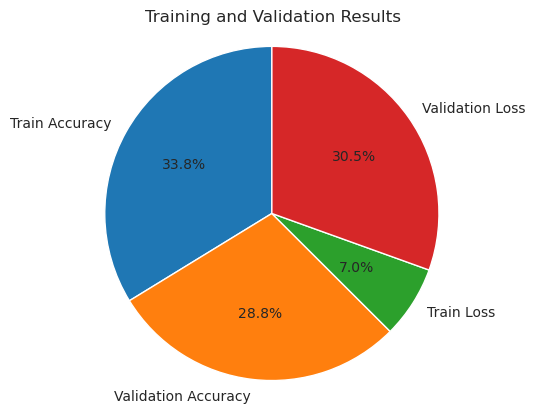

In [67]:
train_acc = history.history['accuracy'][-1]*100
val_acc = history.history['val_accuracy'][-1]*100
train_loss = history.history['loss'][-1]*100
val_loss = history.history['val_loss'][-1]*100

labels = ['Train Accuracy', 'Validation Accuracy', 'Train Loss', 'Validation Loss']
values = [train_acc, val_acc, train_loss, val_loss]

fig, ax = plt.subplots()
ax.pie(values, labels=labels, autopct='%1.1f%%', startangle=90)
ax.axis('equal')

plt.title("Training and Validation Results")
plt.show()


**Data Representation**

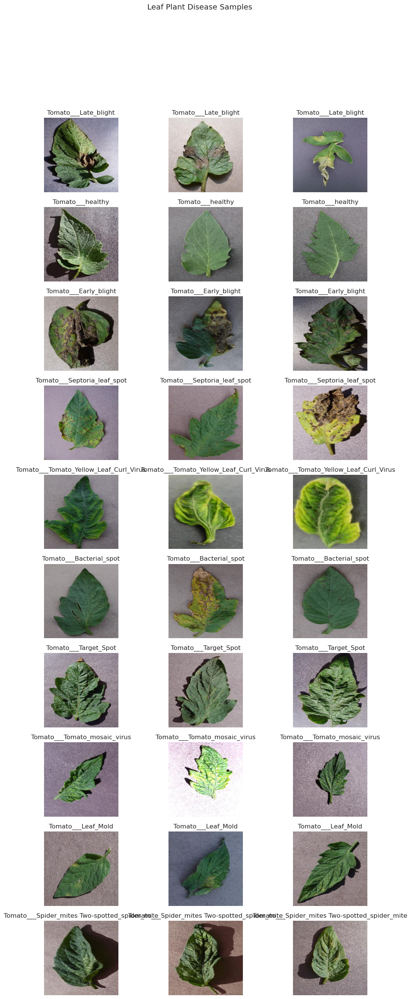

In [72]:
import os
# Get a list of all the folders (i.e. disease types) in the dataset
disease_folders = os.listdir(train)

# Create a figure and axes object
fig, axes = plt.subplots(nrows=len(disease_folders), ncols=3, figsize=(12, 3*len(disease_folders)))

# Loop over each disease folder and plot a sample of three images
for i, folder in enumerate(disease_folders):
    folder_path = os.path.join(train, folder)
    image_files = os.listdir(folder_path)
    sample_images = image_files[:3]
    
    for j, image_file in enumerate(sample_images):
        image_path = os.path.join(folder_path, image_file)
        image = plt.imread(image_path)
        axes[i,j].imshow(image)
        axes[i,j].axis('off')
        axes[i,j].set_title(folder)

# Set the overall plot title and show the plot
plt.suptitle("Leaf Plant Disease Samples")
plt.show()


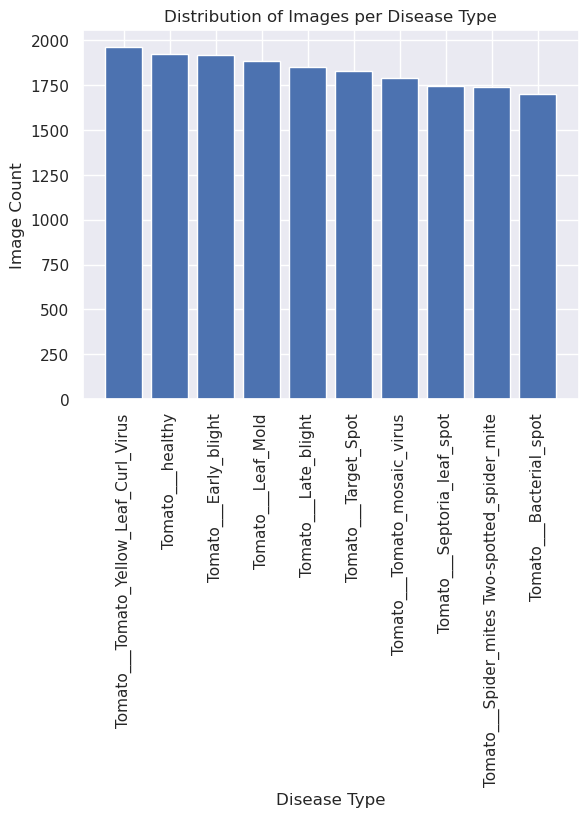

In [74]:

# Define the path to the dataset
dataset_path = train
# Get a list of all the folders (i.e. disease types) in the dataset
disease_folders = os.listdir(dataset_path)

# Count the number of images in each disease folder
image_counts = []
for folder in disease_folders:
    folder_path = os.path.join(dataset_path, folder)
    image_count = len(os.listdir(folder_path))
    image_counts.append(image_count)

# Create a Pandas DataFrame to hold the image counts
df = pd.DataFrame({
    'Disease Type': disease_folders,
    'Image Count': image_counts
})

# Sort the DataFrame by the image counts
df = df.sort_values(by=['Image Count'], ascending=False)

# Create a bar plot of the image counts per disease type
plt.bar(df['Disease Type'], df['Image Count'])
plt.xticks(rotation=90)

plt.title("Distribution of Images per Disease Type")
plt.xlabel("Disease Type")
plt.ylabel("Image Count")
plt.show()


**Model Comparing with Lite Version**

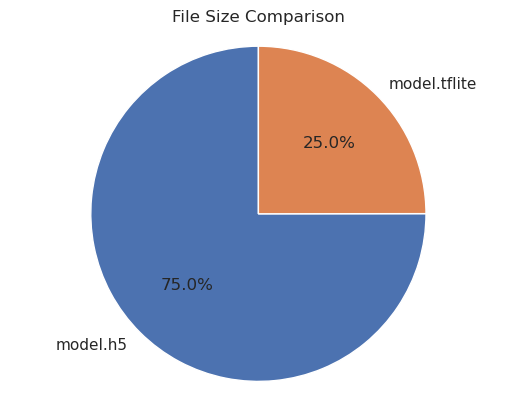

In [75]:

# Define the path to the model files
model_h5_path = "best_model.h5"
model_tflite_path = "modelLite.tflite"

# Get the file sizes of the model files
model_h5_size = os.path.getsize(model_h5_path)
model_tflite_size = os.path.getsize(model_tflite_path)

# Create a pie chart comparing the file sizes
labels = ['model.h5', 'model.tflite']
sizes = [model_h5_size, model_tflite_size]
plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=90)

plt.title("File Size Comparison")
plt.axis('equal')
plt.show()


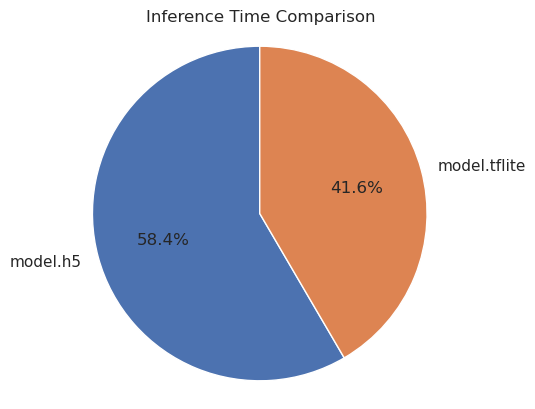

In [78]:
import time
# Load the models and compare their inference speed
# Load the model.h5 file
model_h5 = tf.keras.models.load_model(model_h5_path)

# Load the model.tflite file
interpreter = tf.lite.Interpreter(model_path=model_tflite_path)
interpreter.allocate_tensors()
input_details = interpreter.get_input_details()
output_details = interpreter.get_output_details()

# Create a random input tensor
input_shape = input_details[0]['shape']
input_tensor = tf.random.uniform(input_shape)

# Time the inference of the model.h5 file
start_time = time.time()
output_h5 = model_h5(input_tensor)
end_time = time.time()
inference_time_h5 = end_time - start_time

# Time the inference of the model.tflite file
start_time = time.time()
interpreter.set_tensor(input_details[0]['index'], input_tensor)
interpreter.invoke()
output_tflite = interpreter.get_tensor(output_details[0]['index'])
end_time = time.time()
inference_time_tflite = end_time - start_time

# Create a pie chart comparing the inference time of the models
labels = ['model.h5', 'model.tflite']
sizes = [inference_time_h5, inference_time_tflite]
plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=90)

plt.title("Inference Time Comparison")
plt.axis('equal')
plt.show()


In [125]:
def all_activations_vis(img, layers = 10):
    layer_outputs = [layer.output for layer in model.layers[:layers]]
    activation_model = models.Model(inputs = model.input, outputs = layer_outputs)
    activations = activation_model.predict(img)
    
    layer_names = []
    for layer in model.layers[:layers]: 
        layer_names.append(layer.name) 

    images_per_row = 3
    for layer_name, layer_activation in zip(layer_names, activations): 
        n_features = layer_activation.shape[-1] 

        size = layer_activation.shape[1] 

        n_cols = n_features // images_per_row 
        display_grid = np.zeros((size * n_cols, images_per_row * size)) 

        for col in range(n_cols): 
            for row in range(images_per_row): 
                channel_image = layer_activation[0, :, :, col * images_per_row + row] 
                channel_image -= channel_image.mean() 
                channel_image /= channel_image.std() 
                channel_image *= 64 
                channel_image += 128 
                channel_image = np.clip(channel_image, 0, 255).astype('uint8') 
                display_grid[col * size : (col + 1) * size, 
                             row * size : (row + 1) * size] = channel_image 
        scale = 1. / size 
        plt.figure(figsize=(scale * 5 * display_grid.shape[1], 
                            scale * 5 * display_grid.shape[0])) 
        plt.title(layer_name) 
        plt.grid(False)
        plt.axis('off')
        plt.imshow(display_grid, aspect = 'auto', cmap = 'viridis')

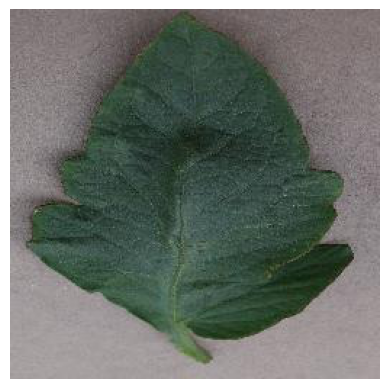

In [127]:
img_path = "/kaggle/input/tomato-plant-dataset/TomattoLeaf/valid/Tomato___Bacterial_spot/01d7f4fe-793f-4a9b-bc8b-8aa05200984f___GCREC_Bact.Sp 2984.JPG"
img =  tf.keras.preprocessing.image.load_img(img_path, target_size = (image_size,image_size))
img_tensor =  tf.keras.preprocessing.image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis = 0)
img_tensor /= 255.

plt.imshow(img_tensor[0])
plt.axis('off')
plt.show()

**Layer of Model to Show How procees the image**

1/1 [==============================] - 0s 72ms/step


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in true_divide
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: divide by zero encountered in true_divide


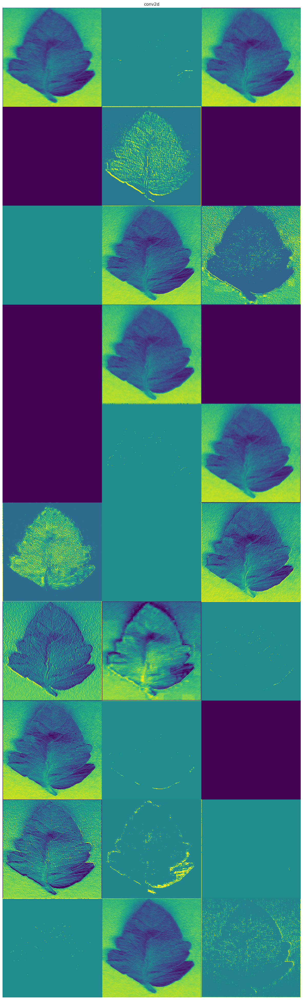

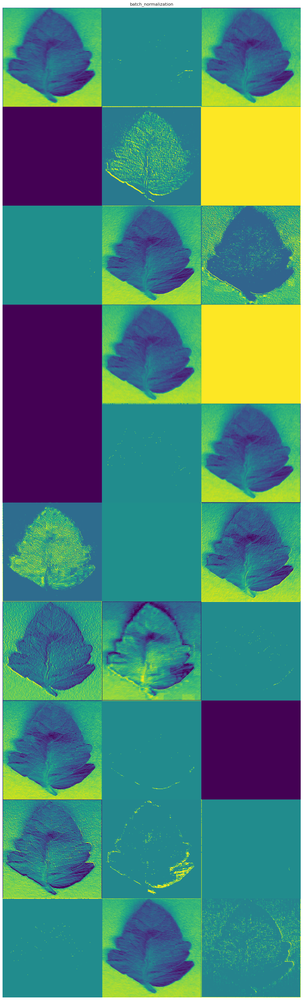

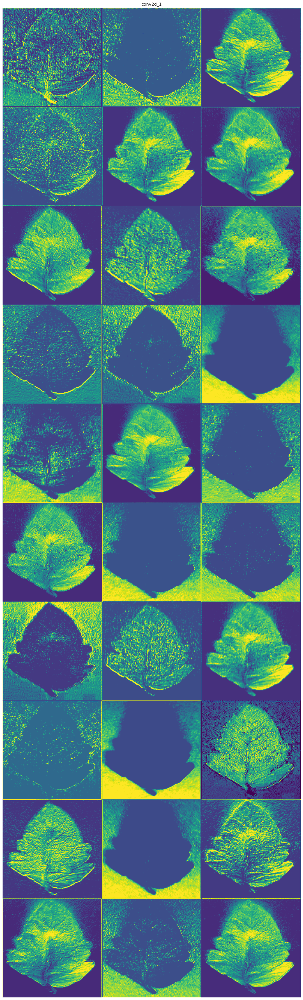

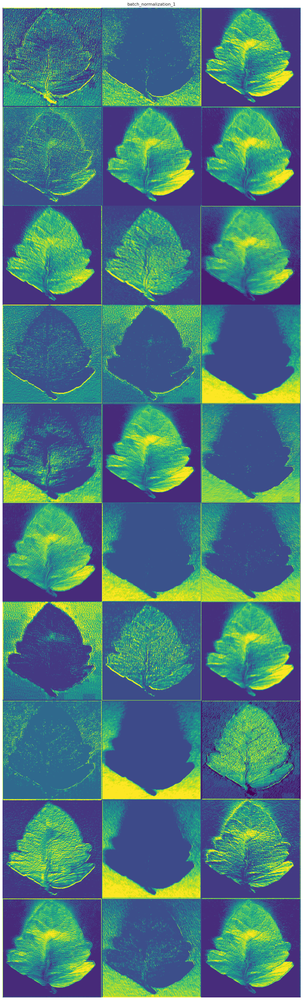

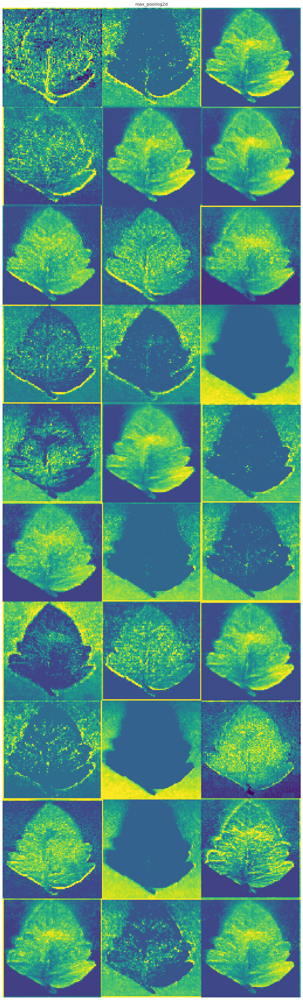

In [128]:
all_activations_vis(img_tensor, 5)

In [129]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 255, 255, 32)      896       
                                                                 
 batch_normalization (BatchN  (None, 255, 255, 32)     128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 255, 255, 32)      9248      
                                                                 
 batch_normalization_1 (Batc  (None, 255, 255, 32)     128       
 hNormalization)                                                 
                                                                 
 max_pooling2d (MaxPooling2D  (None, 85, 85, 32)       0         
 )                                                               
                                                        